## KIVA LOANS ANALYSIS

#### Introduction 

Kiva is an online crowdfunding platform to extend financial services to poor and financially excluded people around the world. Kiva lenders have provided over $1 billion dollars in loans to over 2 million people. In order to set investment priorities, help inform lenders, and understand their target communities, answering some fundamental questions is necessary. However, this requires inference based on a limited set of information for each borrower.

In this project our country in focus will be the Philippines,(though Kenya will be featured in some questions). And the vital questions to be answered are as follows: 

1. what were the top 10 loan uses?
2. Who are the most dominant field partners?
3. What are the names of the partners and their total loan amount?
4. What are the names of the partners and their total funded amount.
5. What are the names of the partners and their total number of loans.
6. Which are the Top Regions by loan amount?
7. What is the correlation of the numerial values using a heatmap?
8. What is the distribution of loan amount?
9. What is the distribution of funded amount? 
10. What is the distribution of the repayment term?
11. What is the lender count against the funded amount? Explain the obtained results. 
12. What is the distribution of funded amount by region?
13. What is the funded amount with the sector as the hue?
14. By using a boxplot show the regions against funded amount.
15. what is the repayment interval for different regions?
16. By using a boxplot show the loan amount in sectors.
17. What is the sector-wise classification of loans based on the top sectors of the top 20 regions?
18. What is the number of field partners by region (MPI data set)?
19. What is the total amount of loans by month? 
20. How many regions are there?
21. What is the number of loans per region?
22. What is the number of loans per sector?
23. Show the distrubution of the disbursed time of the loans. 
##### I sure hope my findings will be an eye opener and a motivation to take necessary actions.

#### Imported necessary liabriaries.
For EDA questions and data cleaning, please have a look at other project "...

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns 
import warnings 
warnings.filterwarnings('ignore')

In [2]:
kiva = pd.read_csv ('../input/data-science-for-good-kiva-crowdfunding/kiva_loans.csv')

In [3]:
philippines = kiva[kiva['country']== 'Philippines']. reset_index (drop = True)

In [4]:
#some loan uses are in repeat with one a "." or " " differentiating them. There, I used the following codes to join them.

philippines ['use'] = philippines ['use'].astype (str) #change to string type
def remove_end_spaces (string): 
    return "".join(string.strip())
philippines ['use'] = philippines ['use'].apply (remove_end_spaces) #to add all the strings together.
transtab = str. maketrans (dict. fromkeys (".",""))
transtab2 = str. maketrans (dict. fromkeys ("-"," "))
philippines ['use'] = '|'.join (philippines ['use']. tolist()).translate (transtab). split ('|') #to split the strings
philippines ['use'] = '|'.join (philippines ['use']. tolist()).translate (transtab2). split ('|') 

#### 1. The top 10 loan uses in the data.

The table below shows the top 10 loan uses, and therefore I can confidently conclude that "to build a sanitary toilet for her family" is the top most reason. 

In [5]:
philippines.columns

Index(['id', 'funded_amount', 'loan_amount', 'activity', 'sector', 'use',
       'country_code', 'country', 'region', 'currency', 'partner_id',
       'posted_time', 'disbursed_time', 'funded_time', 'term_in_months',
       'lender_count', 'tags', 'borrower_genders', 'repayment_interval',
       'date'],
      dtype='object')

In [6]:
philippines ['use'].value_counts().head(10). reset_index()

,index,use
0,to build a sanitary toilet for her family,3307
1,to buy fertilizers and other farm supplies,2253
2,to buy ingredients for her food production bus...,2239
3,to buy feed and vitamins for her pigs,1780
4,to buy feeds and other supplies to raise her pigs,1604
5,to purchase more groceries to sell,1600
6,to buy feed and other supplies to raise her pigs,1542
7,to purchase building materials and pay for con...,1015
8,to buy feeds and vitamins for her pigs,992
9,"to buy feeds, vitamins, and other supplies to ...",988


In [7]:
top10_loan_uses = philippines.groupby('use')['loan_amount'].count().sort_values (ascending = False).reset_index(). head (10)
top10_loan_uses

,use,loan_amount
0,to build a sanitary toilet for her family,3307
1,to buy fertilizers and other farm supplies,2253
2,to buy ingredients for her food production bus...,2239
3,to buy feed and vitamins for her pigs,1780
4,to buy feeds and other supplies to raise her pigs,1604
5,to purchase more groceries to sell,1600
6,to buy feed and other supplies to raise her pigs,1542
7,to purchase building materials and pay for con...,1015
8,to buy feeds and vitamins for her pigs,992
9,"to buy feeds, vitamins, and other supplies to ...",988


[Text(0, 0.5, 'Count')]

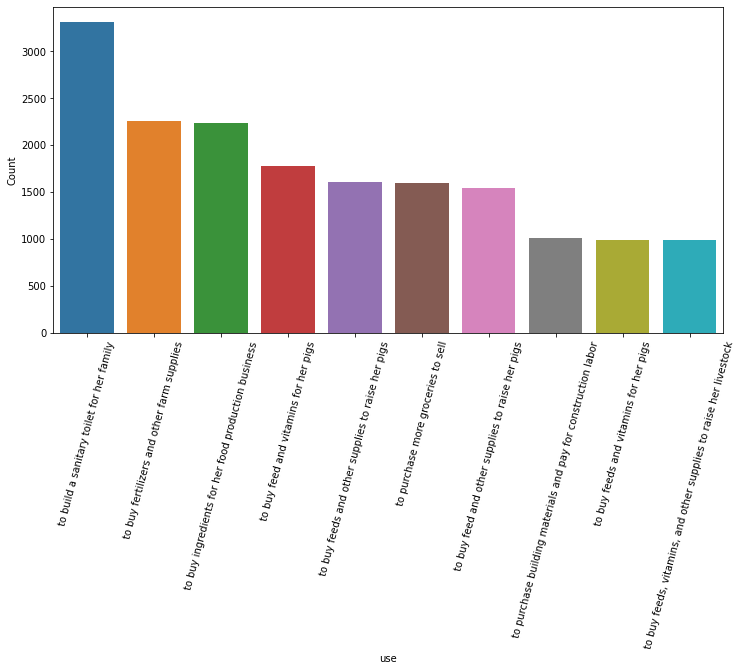

In [8]:
plt.figure (figsize = (12,6))
plt.xticks (rotation = 75)
sns.barplot (x= 'use', y= 'loan_amount', data = top10_loan_uses). set(ylabel= 'Count')

#### 2. The most dominant field partners.

Partner with index 145 is the most dominant partner.

In [9]:
philippines ['partner_id'].value_counts(). reset_index(). head(10)

,index,partner_id
0,145.0,107188
1,125.0,15010
2,126.0,14374
3,136.0,8079
4,144.0,7861
5,123.0,7070
6,389.0,644
7,351.0,208
8,409.0,6
9,508.0,1


In [10]:
dominant_field_partners = philippines.groupby ('partner_id')['lender_count'].count(). sort_values (ascending = False). reset_index().head(10)
dominant_field_partners

,partner_id,lender_count
0,145.0,107188
1,125.0,15010
2,126.0,14374
3,136.0,8079
4,144.0,7861
5,123.0,7070
6,389.0,644
7,351.0,208
8,409.0,6
9,508.0,1


[Text(0, 0.5, 'Count')]

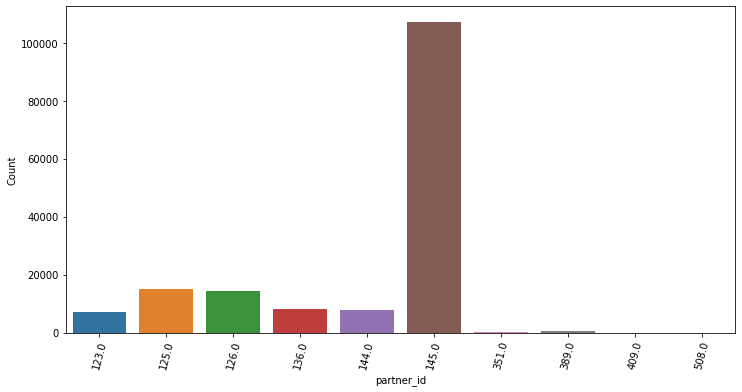

In [11]:
plt.figure (figsize = (12,6))
plt.xticks (rotation = 75)
sns.barplot (x= 'partner_id', y= 'lender_count', data = dominant_field_partners). set(ylabel = 'Count')

#### 3. The partner names and their total loan amount.

NWTF, which is a women group, borrowed the highest total loan amount.

In [12]:
loan_themes = pd.read_csv ('../input/data-science-for-good-kiva-crowdfunding/loan_themes_by_region.csv')
loan_themes.columns

Index(['Partner ID', 'Field Partner Name', 'sector', 'Loan Theme ID',
       'Loan Theme Type', 'country', 'forkiva', 'region', 'geocode_old', 'ISO',
       'number', 'amount', 'LocationName', 'geocode', 'names', 'geo', 'lat',
       'lon', 'mpi_region', 'mpi_geo', 'rural_pct'],
      dtype='object')

In [13]:
phil_partners = loan_themes [loan_themes['country']== 'Philippines'].reset_index(drop = True)

In [14]:
partner_loans = phil_partners.groupby ('Field Partner Name')['amount'].sum(). sort_values (ascending = False). reset_index()
partner_loans

,Field Partner Name,amount
0,Negros Women for Tomorrow Foundation (NWTF),22821800
1,"Community Economic Ventures, Inc. (CEVI)",3017325
2,Paglaum Multi-Purpose Cooperative (PMPC),2477175
3,Alalay sa Kaunlaran (ASKI),2266475
4,CCT Credit Cooperative,1979350
5,Gata Daku Multi-purpose Cooperative (GDMPC),1469550
6,SEED Center Philippines,249375
7,"N/A, direct to Kalsada",25000
8,BagoSphere,9875


<AxesSubplot:xlabel='amount', ylabel='Field Partner Name'>

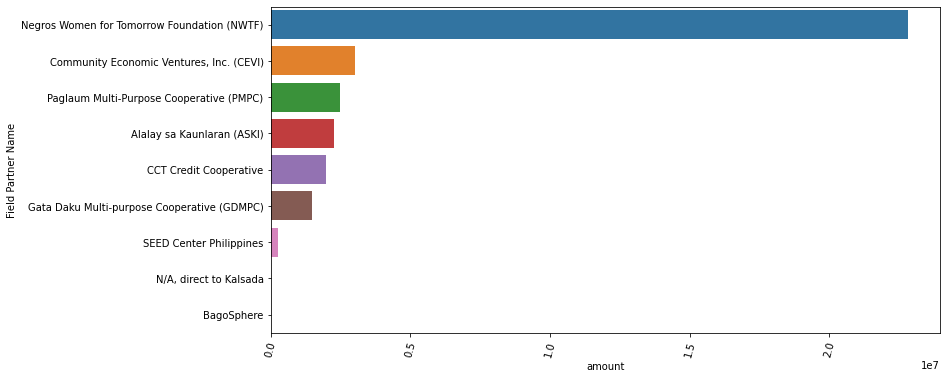

In [15]:
plt.figure (figsize = (12,6))
plt.xticks (rotation = 75)
sns.barplot (x ='amount', y = 'Field Partner Name', data = partner_loans)

#### 4. The partners names and their total funded amount.



In [16]:
# I had to merge loan_themes_by_region with Kiva loans in order to get the partner names and the funded amount.
loan_themes_by_region = pd.read_csv ('../input/data-science-for-good-kiva-crowdfunding/loan_themes_by_region.csv')

In [17]:
philippines_themes_region = loan_themes_by_region [loan_themes_by_region ['country'] == 'Philippines']. reset_index (drop = True)                                                                                                                        

In [18]:
philippines_partner_name_ID = philippines_themes_region [["Partner ID", "Field Partner Name"]].drop_duplicates()
philippines_partner_name_ID.head()

,Partner ID,Field Partner Name
0,123,Alalay sa Kaunlaran (ASKI)
1207,125,"Community Economic Ventures, Inc. (CEVI)"
1420,126,Paglaum Multi-Purpose Cooperative (PMPC)
2093,136,Gata Daku Multi-purpose Cooperative (GDMPC)
3045,144,CCT Credit Cooperative


In [19]:
#the field names must match the ones in the philippines for the merge to be sucessful.
philippines_partner_name_ID.columns = ["partner_id", "field_partner_name"]

In [20]:
merge = pd.merge(philippines, philippines_partner_name_ID, on = 'partner_id').reset_index()

In [21]:
funded_amount_by_partner = merge. groupby('field_partner_name')['funded_amount'].sum().sort_values (ascending = False).reset_index()
funded_amount_by_partner

,field_partner_name,funded_amount
0,Negros Women for Tomorrow Foundation (NWTF),34127900.0
1,Paglaum Multi-Purpose Cooperative (PMPC),5293050.0
2,"Community Economic Ventures, Inc. (CEVI)",4489775.0
3,CCT Credit Cooperative,4325975.0
4,Alalay sa Kaunlaran (ASKI),3310325.0
5,Gata Daku Multi-purpose Cooperative (GDMPC),2453950.0
6,SEED Center Philippines,365875.0
7,BagoSphere,83025.0
8,"N/A, direct to Kalsada",25000.0


#### 5. The partner names and their total number of loans

In [22]:
no_loans_by_partner = phil_partners.groupby ('Field Partner Name')['amount'].count().sort_values (ascending = False). reset_index()
no_loans_by_partner

,Field Partner Name,amount
0,Alalay sa Kaunlaran (ASKI),1207
1,Gata Daku Multi-purpose Cooperative (GDMPC),952
2,Paglaum Multi-Purpose Cooperative (PMPC),673
3,Negros Women for Tomorrow Foundation (NWTF),300
4,"Community Economic Ventures, Inc. (CEVI)",213
5,CCT Credit Cooperative,68
6,SEED Center Philippines,43
7,BagoSphere,10
8,"N/A, direct to Kalsada",1


[Text(0.5, 0, 'No.of Loans')]

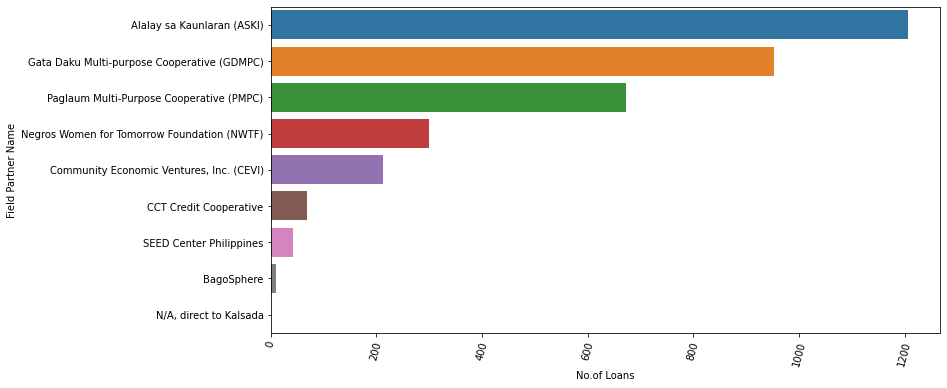

In [23]:
plt.figure (figsize = (12,6))
plt.xticks (rotation = 75)
sns.barplot (x ='amount', y = 'Field Partner Name', data = no_loans_by_partner).set (xlabel = 'No.of Loans')

#### 6. Top Regions by loan amount

In [24]:
loan_amount_by_regions = philippines.groupby ('region')['loan_amount'].sum().sort_values(ascending = False). reset_index().head(10)
loan_amount_by_regions 

,region,loan_amount
0,"Narra, Palawan",1235750.0
1,"Quezon, Palawan",1211875.0
2,"Brookes Point, Palawan",1181175.0
3,"Kabankalan, Negros Occidental",1045225.0
4,"Hinigaran, Negros Occidental",967900.0
5,"Cordova, Cebu",925850.0
6,"Isabela, Negros Occidental",896900.0
7,"Bais, Negros Oriental",844775.0
8,"Dumaguete, Negros Oriental",819950.0
9,"Roxas City, Capiz",752100.0


In [25]:
fig = px.pie(loan_amount_by_regions, values ='loan_amount', names='region', title='Loan Amount by Regions')
fig

#### 7. The correlation of the numerial values using a heatmap.

In [26]:
philippines.columns

Index(['id', 'funded_amount', 'loan_amount', 'activity', 'sector', 'use',
       'country_code', 'country', 'region', 'currency', 'partner_id',
       'posted_time', 'disbursed_time', 'funded_time', 'term_in_months',
       'lender_count', 'tags', 'borrower_genders', 'repayment_interval',
       'date'],
      dtype='object')

In [27]:
num_values = philippines[['funded_amount', 'loan_amount', 'posted_time', 'disbursed_time', 'funded_time', 'term_in_months','lender_count']].head()
num_values 

,funded_amount,loan_amount,posted_time,disbursed_time,funded_time,term_in_months,lender_count
0,175.0,175.0,2014-01-02 00:25:40+00:00,2013-12-12 08:00:00+00:00,2014-01-02 01:42:51+00:00,8.0,6
1,175.0,175.0,2014-01-02 04:18:30+00:00,2013-12-06 08:00:00+00:00,2014-01-02 07:47:28+00:00,8.0,7
2,700.0,700.0,2014-01-02 02:18:02+00:00,2013-12-10 08:00:00+00:00,2014-01-02 03:26:10+00:00,5.0,2
3,575.0,575.0,2014-01-02 13:38:42+00:00,2013-12-05 08:00:00+00:00,2014-01-02 23:01:23+00:00,8.0,19
4,325.0,325.0,2014-01-02 09:13:05+00:00,2013-12-13 08:00:00+00:00,2014-01-02 17:50:06+00:00,7.0,11


In [28]:
num_values.corr()

,funded_amount,loan_amount,term_in_months,lender_count
funded_amount,1.000000,1.000000,-0.696224,0.101815
loan_amount,1.000000,1.000000,-0.696224,0.101815
term_in_months,-0.696224,-0.696224,1.000000,0.565516
lender_count,0.101815,0.101815,0.565516,1.000000


<AxesSubplot:>

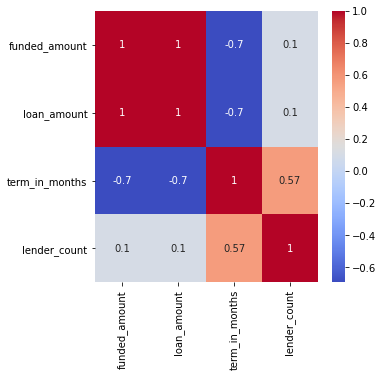

In [29]:
plt.figure(figsize = (5,5))
sns.heatmap (num_values.corr(), annot = True, cmap = 'coolwarm')

#### 8. The distribution of loan amount.

In [30]:
philippines.dropna (subset =['borrower_genders'], inplace = True)

In [31]:
fig = px.histogram (philippines, x = 'loan_amount', facet_row = 'borrower_genders')
fig.update_layout(yaxis_range = [0,1000],xaxis_range=[0, 4000])
fig

#### 9. The distribution of funded amount.

In [32]:
px.histogram (philippines, x = 'funded_amount',range_x = [0,1000], color = 'borrower_genders')

#### 10. The distribution of repayment term.

In [33]:
px.histogram (philippines, x = 'repayment_interval')

#### 11. The lender count against the funded amount. Explain the obtained results. 

In [34]:
lender_count_funded_amount = philippines.groupby('borrower_genders')[['lender_count', 'funded_amount']].sum().sort_values (by ='funded_amount').reset_index()
lender_count_funded_amount

,borrower_genders,lender_count,funded_amount
0,male,95844,3493750.0
1,female,1281649,50944325.0


In [35]:
px.scatter (philippines, x = 'funded_amount', y = 'lender_count', color = 'borrower_genders', size = 'funded_amount', hover_data = ['loan_amount'])

#### 12. The distribution of funded amount by region. 

In [36]:
dist_by_region = philippines.groupby ('region')['funded_amount'].sum().sort_values (ascending = False). reset_index().head (10)
dist_by_region

,region,funded_amount
0,"Narra, Palawan",1234625.0
1,"Quezon, Palawan",1210875.0
2,"Brookes Point, Palawan",1180100.0
3,"Kabankalan, Negros Occidental",1040700.0
4,"Hinigaran, Negros Occidental",956950.0
5,"Cordova, Cebu",902675.0
6,"Isabela, Negros Occidental",886500.0
7,"Bais, Negros Oriental",829800.0
8,"Dumaguete, Negros Oriental",807850.0
9,"Roxas City, Capiz",750525.0


<AxesSubplot:xlabel='region', ylabel='funded_amount'>

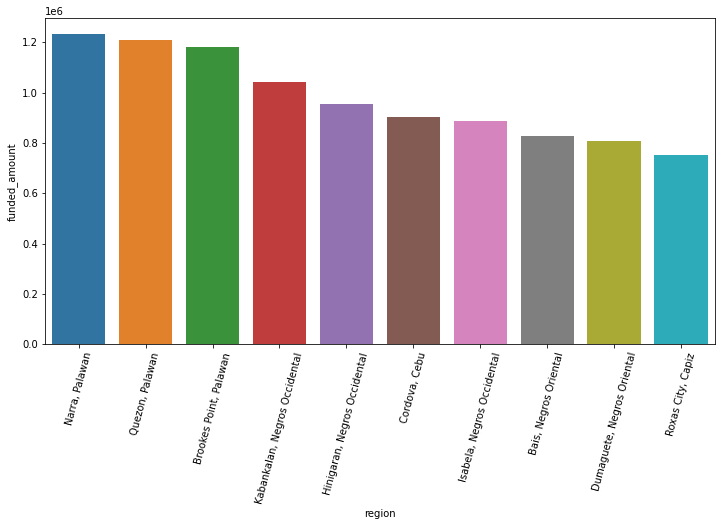

In [37]:
plt.figure (figsize = (12,6))
plt.xticks (rotation = 75)
sns.barplot (x ='region', y = 'funded_amount', data = dist_by_region)

#### 13. The funded amount with the sector as the hue. 

In [38]:
funded_amount_by_sector = philippines.groupby ('sector')['funded_amount'].sum().sort_values (ascending = False). reset_index().head (10)
funded_amount_by_sector

,sector,funded_amount
0,Retail,18837500.0
1,Food,14553650.0
2,Agriculture,11807000.0
3,Services,1819800.0
4,Housing,1808700.0
5,Transportation,1658325.0
6,Clothing,1070875.0
7,Education,700925.0
8,Arts,582150.0
9,Manufacturing,546050.0


In [39]:
px.scatter (funded_amount_by_sector, x = 'funded_amount', y = 'sector', color = 'sector', size = 'funded_amount')

#### 14. A box plot of regions against funded amount.

In [40]:
dist_by_region.head()

,region,funded_amount
0,"Narra, Palawan",1234625.0
1,"Quezon, Palawan",1210875.0
2,"Brookes Point, Palawan",1180100.0
3,"Kabankalan, Negros Occidental",1040700.0
4,"Hinigaran, Negros Occidental",956950.0


In [41]:
fig2 = px.box(dist_by_region, y="funded_amount", x = 'region') 
fig2.show()

#### 15. The repayment interval for different regions.

In [42]:
repayment_interval = philippines.groupby (['region', 'repayment_interval'])['loan_amount'].sum().sort_values(ascending = False). reset_index().head (10)
repayment_interval

,region,repayment_interval,loan_amount
0,"Narra, Palawan",irregular,1235750.0
1,"Quezon, Palawan",irregular,1211875.0
2,"Brookes Point, Palawan",irregular,1181175.0
3,"Kabankalan, Negros Occidental",irregular,1044600.0
4,"Hinigaran, Negros Occidental",irregular,959750.0
5,"Cordova, Cebu",irregular,925850.0
6,"Isabela, Negros Occidental",irregular,896525.0
7,"Bais, Negros Oriental",irregular,844775.0
8,"Dumaguete, Negros Oriental",irregular,819950.0
9,"Roxas City, Capiz",irregular,752100.0


In [43]:
philippines.columns

Index(['id', 'funded_amount', 'loan_amount', 'activity', 'sector', 'use',
       'country_code', 'country', 'region', 'currency', 'partner_id',
       'posted_time', 'disbursed_time', 'funded_time', 'term_in_months',
       'lender_count', 'tags', 'borrower_genders', 'repayment_interval',
       'date'],
      dtype='object')

<AxesSubplot:title={'center':'Repayment_interval by Region'}, xlabel='region', ylabel='loan_amount'>

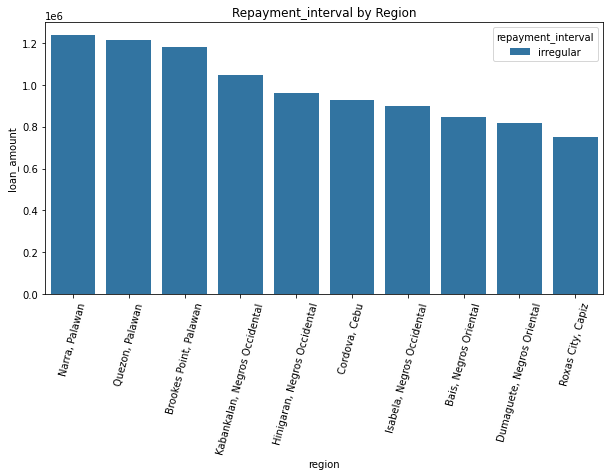

In [44]:
plt.figure (figsize=(10,5))
plt.xticks (rotation=75)
plt.title ('Repayment_interval by Region')
sns.barplot(x='region', y='loan_amount', data=repayment_interval, ci =None, estimator=np.sum, hue= 'repayment_interval')

#### 16. Boxplots of the loan amount in sectors.

In [45]:
fig3 = px.box (philippines, y = 'loan_amount', x = 'sector', height = 800, color = 'sector')
fig3.update_yaxes (
    range = (0,2000), constrain= 'domain')
fig3.show ()

#### 17. Sector-wise classification of loans based on the top sectors of the top 20 regions.

In [46]:
loan_amount_by_sector_tp20regions = philippines.groupby (['sector', 'region'])['loan_amount'].sum().sort_values (ascending = False). reset_index().head (20)
loan_amount_by_sector_tp20regions

,sector,region,loan_amount
0,Food,"Concepcion, Iloilo",521525.0
1,Food,"Brookes Point, Palawan",507225.0
2,Retail,"Kabankalan, Negros Occidental",474425.0
3,Food,"Quezon, Palawan",472275.0
4,Retail,"Narra, Palawan",455775.0
5,Food,"Narra, Palawan",440125.0
6,Retail,"Isabela, Negros Occidental",424025.0
7,Retail,"Cordova, Cebu",417225.0
8,Retail,"Brookes Point, Palawan",407625.0
9,Retail,"Quezon, Palawan",397350.0


In [47]:
px.bar (data_frame =loan_amount_by_sector_tp20regions, x = 'region', y = 'loan_amount', title = 'Loan Amount by Region', color = 'sector')

#### 18. The number of field partners by region (MPI data set).

In [48]:
phil_partners.columns

Index(['Partner ID', 'Field Partner Name', 'sector', 'Loan Theme ID',
       'Loan Theme Type', 'country', 'forkiva', 'region', 'geocode_old', 'ISO',
       'number', 'amount', 'LocationName', 'geocode', 'names', 'geo', 'lat',
       'lon', 'mpi_region', 'mpi_geo', 'rural_pct'],
      dtype='object')

In [49]:
phil_partners_by_mpiregion = phil_partners.groupby ('mpi_region')['Partner ID']. count(). sort_values (ascending = False ). reset_index()
phil_partners_by_mpiregion

,mpi_region,Partner ID
0,"Northern Mindanao, Philippines",1174
1,"Cagayan Valley, Philippines",816
2,PHL,384
3,"Central Visayas, Philippines",346
4,"Cordillera Admin Region, Philippines",215
5,"Western Visayas, Philippines",155
6,"Armm, Philippines",107
7,"Calabarzon, Philippines",99
8,"Ilocos Region, Philippines",70
9,"Eastern Visayas, Philippines",41


In [50]:
px.bar (data_frame =phil_partners_by_mpiregion, x = 'mpi_region', y = 'Partner ID')

#### 19. The months and the total number of loans in that month.

In [51]:
philippines ['date']

0         2014-01-02
1         2014-01-02
2         2014-01-02
3         2014-01-02
4         2014-01-02
             ...    
160436    2017-07-07
160437    2017-07-07
160438    2017-07-07
160439    2017-07-07
160440    2017-07-07
Name: date, Length: 160361, dtype: object

In [52]:
philippines['date'] = pd.to_datetime (philippines['date'])
philippines['date']

0        2014-01-02
1        2014-01-02
2        2014-01-02
3        2014-01-02
4        2014-01-02
            ...    
160436   2017-07-07
160437   2017-07-07
160438   2017-07-07
160439   2017-07-07
160440   2017-07-07
Name: date, Length: 160361, dtype: datetime64[ns]

In [53]:
philippines['date'].dt.year

0         2014
1         2014
2         2014
3         2014
4         2014
          ... 
160436    2017
160437    2017
160438    2017
160439    2017
160440    2017
Name: date, Length: 160361, dtype: int64

In [54]:
philippines['date'].dt.month

0         1
1         1
2         1
3         1
4         1
         ..
160436    7
160437    7
160438    7
160439    7
160440    7
Name: date, Length: 160361, dtype: int64

In [55]:
philippines['date'].dt.day

0         2
1         2
2         2
3         2
4         2
         ..
160436    7
160437    7
160438    7
160439    7
160440    7
Name: date, Length: 160361, dtype: int64

In [56]:
philippines['year']= philippines['date'].dt.year
philippines['month']= philippines['date'].dt.month
philippines['day']= philippines['date'].dt.day
philippines.sample()

,id,funded_amount,loan_amount,activity,sector,use,country_code,country,region,currency,...,funded_time,term_in_months,lender_count,tags,borrower_genders,repayment_interval,date,year,month,day
44024,851560,375.0,375.0,Fish Selling,Food,to buy more fish to sell to her customers,PH,Philippines,"Kalibo, Aklan",PHP,...,2015-03-13 01:41:20+00:00,8.0,5,volunteer_pick,female,irregular,2015-03-06,2015,3,6


In [57]:
loans_by_month= philippines.groupby('month')['loan_amount'].count(). sort_values (ascending = False ). reset_index()
loans_by_month

,month,loan_amount
0,6,17481
1,5,16873
2,3,16341
3,2,15389
4,4,14790
5,10,12844
6,11,12373
7,9,12282
8,7,12247
9,1,10326


In [58]:
px.bar(data_frame = loans_by_month, x = 'month', y = 'loan_amount', title= 'Loans by Month')

In [59]:
philippines.columns

Index(['id', 'funded_amount', 'loan_amount', 'activity', 'sector', 'use',
       'country_code', 'country', 'region', 'currency', 'partner_id',
       'posted_time', 'disbursed_time', 'funded_time', 'term_in_months',
       'lender_count', 'tags', 'borrower_genders', 'repayment_interval',
       'date', 'year', 'month', 'day'],
      dtype='object')

#### 20. The number of regions.

In [60]:
philippines['region']. nunique()

3638

In [61]:
region_nos = philippines.groupby ('region')['id']. count (). reset_index()
region_nos

,region,id
0,"214 Bonifacio St. Calaocan, Alicia, Isabela",1
1,26 barrientos st. oroquieta city,1
2,ALANG-ALANG AURORA ZAMBO.SUR,6
3,"ALIAGA, NUEVA ECIJA",3
4,"ANONANG,AURORA ZAMBO.SUR",5
...,...,...
3633,"villaflor, oro. city",1
3634,"villaflor, oro.city",1
3635,"villaflor,oroquieta city",1
3636,western pob. lopez jaena,1


#### 21. The number of loans per region.

In [62]:
loan_nos_by_region = philippines.groupby ('region')['id'].count().sort_values(ascending = False). reset_index().head(10)
loan_nos_by_region

,region,id
0,"Palo, Leyte",3320
1,"Narra, Palawan",3197
2,"Quezon, Palawan",3120
3,"Tacloban City, Leyte",2843
4,"Brookes Point, Palawan",2793
5,"Kabankalan, Negros Occidental",2792
6,"Bais, Negros Oriental",2665
7,"Cordova, Cebu",2617
8,"Roxas City, Capiz",2580
9,"Banga, Aklan",2526


In [63]:
px.bar(data_frame = loan_nos_by_region, x = 'region', y = 'id', title= 'No. of Loans by Region')

#### 22. The number of loans per sector.

In [64]:
loan_nos_by_sector = philippines.groupby ('sector')['id'].count().sort_values(ascending = False). reset_index().head(10)
loan_nos_by_sector

,sector,id
0,Retail,53560
1,Food,42684
2,Agriculture,36762
3,Housing,6785
4,Transportation,4564
5,Services,4472
6,Clothing,2760
7,Arts,1990
8,Personal Use,1942
9,Education,1758


In [65]:
px.bar(data_frame = loan_nos_by_sector, x = 'sector', y = 'id', title= 'No. of Loans by Sector')

In [66]:
philippines.columns

Index(['id', 'funded_amount', 'loan_amount', 'activity', 'sector', 'use',
       'country_code', 'country', 'region', 'currency', 'partner_id',
       'posted_time', 'disbursed_time', 'funded_time', 'term_in_months',
       'lender_count', 'tags', 'borrower_genders', 'repayment_interval',
       'date', 'year', 'month', 'day'],
      dtype='object')

#### 23. The distrubution of the disbursed time of the loans.

In [67]:
px.histogram (philippines, x = 'disbursed_time')

#### 24. The distrubution of the funded time of the loans.

In [68]:
px.histogram (philippines, x = 'funded_time')